In [1]:
from pytube import YouTube
import pandas as pd
import cv2
from tqdm import tqdm
import os
import moviepy.editor as mp
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from sklearn import metrics
import math
import glob
import ffmpeg
import pickle
import torchaudio
import librosa
import librosa.display

In [2]:
music_list = pd.read_csv('/opt/ml/ytdataset/pianoyt.csv', names=["index", "link", "train/test", "crop_minY", "crop_maxY", "crop_minX", "crop_maxX"])

In [3]:
music_list = music_list[music_list['train/test'] == 1].iloc[10:20]

In [4]:
music_list

,index,link,train/test,crop_minY,crop_maxY,crop_minX,crop_maxX
10,110,'https://www.youtube.com/watch?v=ks-vhdO-dK0',1,673,993,52,1869
11,111,'https://www.youtube.com/watch?v=RlsIRRdK8d0',1,677,1029,44,1865
12,112,'https://www.youtube.com/watch?v=33q2dAq5w0E',1,674,1017,46,1865
13,113,'https://www.youtube.com/watch?v=IM8KnSzO5Dg',1,674,989,42,1871
14,114,'https://www.youtube.com/watch?v=mAE2NSuBz2U',1,670,1001,37,1877
15,115,'https://www.youtube.com/watch?v=rQV0XKXoOE4',1,662,984,51,1872
17,117,'https://www.youtube.com/watch?v=ZHCjU_rcQno',1,677,1008,41,1875
18,118,'https://www.youtube.com/watch?v=KYnR1zl7kFg',1,672,994,39,1872
19,119,'https://www.youtube.com/watch?v=e01ulR5KMWI',1,671,993,40,1875
20,120,'https://www.youtube.com/watch?v=kkcPOcxME-Q',1,672,987,43,1873


In [15]:
yt = YouTube('https://www.youtube.com/watch?v=bAS4XoMwsWw')
for stream in yt.streams:
    print(stream)

<Stream: itag="17" mime_type="video/3gpp" res="144p" fps="6fps" vcodec="mp4v.20.3" acodec="mp4a.40.2" progressive="True" type="video">
<Stream: itag="18" mime_type="video/mp4" res="360p" fps="25fps" vcodec="avc1.42001E" acodec="mp4a.40.2" progressive="True" type="video">
<Stream: itag="22" mime_type="video/mp4" res="720p" fps="25fps" vcodec="avc1.64001F" acodec="mp4a.40.2" progressive="True" type="video">
<Stream: itag="137" mime_type="video/mp4" res="1080p" fps="25fps" vcodec="avc1.640028" progressive="False" type="video">
<Stream: itag="248" mime_type="video/webm" res="1080p" fps="25fps" vcodec="vp9" progressive="False" type="video">
<Stream: itag="136" mime_type="video/mp4" res="720p" fps="25fps" vcodec="avc1.4d401f" progressive="False" type="video">
<Stream: itag="247" mime_type="video/webm" res="720p" fps="25fps" vcodec="vp9" progressive="False" type="video">
<Stream: itag="135" mime_type="video/mp4" res="480p" fps="25fps" vcodec="avc1.4d401e" progressive="False" type="video">
<St

In [16]:
yt.streams.get_highest_resolution()

<Stream: itag="22" mime_type="video/mp4" res="720p" fps="25fps" vcodec="avc1.64001F" acodec="mp4a.40.2" progressive="True" type="video">

In [5]:
os.makedirs("./videos/train/", exist_ok=True)
os.makedirs("./videos/test/", exist_ok=True)
for _, (is_train, music_link, music_idx) in tqdm(music_list[['train/test', 'link', 'index']].iterrows(), total=music_list.shape[0]):
    if is_train == 1:
        output_path = "/opt/ml/ytdataset/audio_videos/train/"
    else:
        output_path = "/opt/ml/ytdataset/audio_videos/test/"
    try:
        yt = YouTube(music_link)
        yt.streams.filter(
                        res="720p",
                        fps=25,
                        video_codec="avc1.64001F",
                        audio_codec="mp4a.40.2").first().download(output_path=output_path, filename_prefix=f"{music_idx}_")
    except Exception as e:
        print(e)
        # print(f"failed to download : {music_idx}, {music_link}")

100%|██████████| 10/10 [01:52<00:00, 11.25s/it]


In [2]:
video_path = '/opt/ml/final_project/videos/train/100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano.mp4'
video = mp.VideoFileClip(video_path)

In [4]:
next(video.iter_frames()).shape

(720, 1280, 3)

In [10]:
os.path.basename("/opt/ml/ytdataset/videos/train/100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano.mp4")[:-4]

'100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano'

In [16]:
target_path

'/opt/ml/ytdataset/crop_images/train/229_Bach Prelude and Fugue No9 Well Tempered Clavier Book 1 with Harmonic Pedal.mp4/2380.png'

In [25]:
vid_obj.filter()

input(filename='/opt/ml/ytdataset/videos/train/100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano.mp4')[None] <5ac3fd6bab46>

100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano.mp4 :key detected in 219 frame


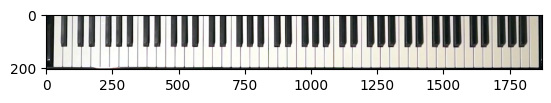

In [2]:
from ultralytics import YOLO
model = YOLO("/opt/ml/data/models/piano_detection.pt")
src_videos = "/opt/ml/ytdataset/videos/train/*"
video_path = sorted(glob.glob(src_videos))[0]
video = mp.VideoFileClip(video_path)
key_detected = False
key_xyxy = None
for i, frame in enumerate(video.iter_frames()):
    if not key_detected:
        output = model.predict(source=frame, device='0', verbose=False)
        if output[0].boxes:
            if output[0].boxes.conf.item() > 0.8:
                key_xyxy = tuple(np.array(output[0].boxes.xyxy.detach().cpu()[0], dtype=int))
                key_detected = True
                print(f"{os.path.basename(video_path)} :key detected in {i} frame")
                break
if not key_detected:
    print(f"no piano key in {os.path.basename(video_path)}")

xmin, ymin, xmax, ymax = key_xyxy
plt.imshow(frame[ymin:ymax, xmin:xmax, ...])

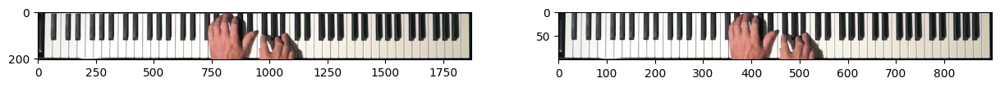

In [11]:
# for i, frame in enumerate(video.iter_frames()):
#     if i == 3000:
#         break

cropped = frame[ymin:ymax, xmin:xmax, ...].copy()
plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(cropped)
resized = cv2.resize(cropped, (900, 100))
plt.subplot(1, 2, 2)
plt.imshow(resized)

In [9]:
from ultralytics import YOLO
model = YOLO("/opt/ml/data/models/piano_detection.pt")

src_videos = "/opt/ml/ytdataset/videos/train/*"
target_dir = "/opt/ml/ytdataset/crop_images/train/"
os.makedirs(target_dir, exist_ok=True)
video_paths = sorted(glob.glob(src_videos))[10:20]

for i, video_path in tqdm(enumerate(video_paths), total=len(video_paths)):
    print(os.path.basename(video_path))
    video = mp.VideoFileClip(video_path)
    key_detected = False
    key_xyxy = None
    for i, frame in enumerate(video.iter_frames()):
        if not key_detected:
            output = model.predict(source=frame, device='0', verbose=False)
            if output[0].boxes:
                if output[0].boxes.conf.item() > 0.8:
                    key_xyxy = tuple(np.array(output[0].boxes.xyxy.detach().cpu()[0], dtype=int))
                    key_detected = True
                    print(f"{os.path.basename(video_path)} :key detected in {i} frame")
                    break
    if not key_detected:
        print(f"no piano key in {os.path.basename(video_path)}")
        continue
    vid_obj = ffmpeg.input(video_path)
    xmin, ymin, xmax, ymax = key_xyxy
    dst_dir = target_dir + os.path.basename(video_path)
    os.makedirs(dst_dir, exist_ok=True)
    vid_obj.filter("fps", fps=25).filter("crop", xmax-xmin, ymax-ymin, xmin, ymin).filter("scale", "900", "100").output(os.path.join(dst_dir, "%04d.png"), **{"qmin": 1, "qmax": 1}).run()
    # for i, frame in enumerate(video.iter_frames()):
    #     frame_crop = frame[ymin:ymax, xmin:xmax, ...]
    #     os.makedirs(dst_dir, exist_ok=True)
    #     target_path = os.path.join(dst_dir, f"{i+1}.png")
    #     cv2.imwrite(target_path, frame_crop)

  0%|          | 0/10 [00:00<?, ?it/s]

110_Lullaby Op13 No7 - A Ilyinsky - P Barton FEURICH piano.mp4
110_Lullaby Op13 No7 - A Ilyinsky - P Barton FEURICH piano.mp4 :key detected in 219 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

111_Bach Prelude and Fugue No 15 Well Tempered Clavier Book 2 with Harmonic Pedal.mp4
111_Bach Prelude and Fugue No 15 Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 :key detected in 249 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

112_Bach Prelude and Fugue No14 (ModerateFast tempo) Well Tempered Clavier Book 2 with Harmonic Pedal.mp4
112_Bach Prelude and Fugue No14 (ModerateFast tempo) Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 :key detected in 249 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

113_Bach Prelude and Fugue No14 (SlowModerate tempo) Well Tempered Clavier Book 2 with Harmonic Pedal.mp4
113_Bach Prelude and Fugue No14 (SlowModerate tempo) Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 :key detected in 249 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

114_Scarlatti Sonata K32 - Paul Barton FEURICH piano.mp4
114_Scarlatti Sonata K32 - Paul Barton FEURICH piano.mp4 :key detected in 219 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

115_Bach Prelude and Fugue No13 Well Tempered Clavier Book 2 with Harmonic Pedalpiano.mp4
115_Bach Prelude and Fugue No13 Well Tempered Clavier Book 2 with Harmonic Pedalpiano.mp4 :key detected in 222 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

117_Pachelbel “Canon in D” (arr T Andersen) P Barton FEURICH piano.mp4
117_Pachelbel “Canon in D” (arr T Andersen) P Barton FEURICH piano.mp4 :key detected in 219 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

118_Scott Joplin “Maple Leaf Rag” Paul Barton FEURICH HP piano.mp4
118_Scott Joplin “Maple Leaf Rag” Paul Barton FEURICH HP piano.mp4 :key detected in 219 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

119_Scott Joplin The Entertainer Paul Barton FEURICH HP piano.mp4
119_Scott Joplin The Entertainer Paul Barton FEURICH HP piano.mp4 :key detected in 219 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

120_Bach Preludes and Fugues 13-24 Well Tempered Clavier Book 1 PIANO + SCORE.mp4
120_Bach Preludes and Fugues 13-24 Well Tempered Clavier Book 1 PIANO + SCORE.mp4 :key detected in 249 frame


ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [27]:
os.path.join("/opt/ml/ytdataset/audios/train/", "asda.mp4")

'/opt/ml/ytdataset/audios/train/asda.mp4'

In [10]:
src_audios = "/opt/ml/ytdataset/audio_videos/train/*"
audio_dst_dir = "/opt/ml/ytdataset/audios/train/"
os.makedirs(audio_dst_dir, exist_ok=True)
audio_paths = sorted(glob.glob(src_audios))[10:]
for i, audio_path in enumerate(audio_paths):

    video = mp.VideoFileClip(audio_path)

    # 오디오 추출
    audio_array = video.audio.to_soundarray()
    mono_audio = np.mean(audio_array, axis=1)
    # print(samples_per_frame)

    cnt = len(glob.glob(audio_path.replace('audio_videos', 'crop_images') + "/*"))
    print(mono_audio.shape[0], cnt)
    samples_per_frame = mono_audio.shape[0] // cnt # math.ceil(mono_audio.shape[0] / cnt)
    # audio_frames = mono_audio.shape[0] // 44100 * 25
    # if audio_frames < cnt:
    #     mono_audio = np.pad(mono_audio, (0, int((cnt - audio_frames) / 25 * 44100)), mode='constant')
    #     print("add padding")
    
    audio_dict = {}
    for i in range(cnt):
        curr_audio = mono_audio[i * samples_per_frame:(i + 1) * samples_per_frame]
        audio_dict[i+1] = curr_audio
        # prev_audio = mono_audio[(i-1) * samples_per_frame:(i) * samples_per_frame]
        # audio_dict[i+1] = prev_audio if len(curr_audio) < len(prev_audio) else curr_audio
    print(f"{os.path.basename(audio_path)} | samples_per_frame : {samples_per_frame} | last : {audio_dict[cnt].shape[0]} | prev: {audio_dict[cnt-1].shape[0]}")

    target_path = os.path.join(audio_dst_dir, os.path.basename(audio_path)) + ".pickle"
    
    with open(target_path, "wb") as f:
        pickle.dump(audio_dict, f)


11020149 6247
110_Lullaby Op13 No7 - A Ilyinsky - P Barton FEURICH piano.mp4 | samples_per_frame : 1764 | last : 1764 | prev: 1764
11530386 6536
111_Bach Prelude and Fugue No 15 Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 | samples_per_frame : 1764 | last : 1764 | prev: 1764
18326637 10389
112_Bach Prelude and Fugue No14 (ModerateFast tempo) Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 | samples_per_frame : 1764 | last : 1764 | prev: 1764
21472290 12172
113_Bach Prelude and Fugue No14 (SlowModerate tempo) Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 | samples_per_frame : 1764 | last : 1764 | prev: 1764
9665397 5479
114_Scarlatti Sonata K32 - Paul Barton FEURICH piano.mp4 | samples_per_frame : 1764 | last : 1764 | prev: 1764
16463853 9333
115_Bach Prelude and Fugue No13 Well Tempered Clavier Book 2 with Harmonic Pedalpiano.mp4 | samples_per_frame : 1764 | last : 1764 | prev: 1764
11645928 6602
117_Pachelbel “Canon in D” (arr T Andersen) P Barton FEURICH piano.mp

In [86]:
def extract_mfcc(audio_data, sample_rate):
    # MFCC를 추출할 파라미터 설정
    n_mfcc = 13  # MFCC의 개수
    n_fft = 2048  # STFT(Fast Fourier Transform)에 사용되는 FFT 크기
    hop_length = 512  # STFT에서 프레임 간격

    # MFCC 추출
    mfcc = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=n_mfcc, n_fft=n_fft, hop_length=hop_length)

    return mfcc

src_audios = "/opt/ml/ytdataset/audio_videos/test/*"
audio_dst_dir = "/opt/ml/ytdataset/audios_mfcc/test/"
os.makedirs(audio_dst_dir, exist_ok=True)
audio_paths = sorted(glob.glob(src_audios))
for i, audio_path in enumerate(audio_paths):

    video = mp.VideoFileClip(audio_path)

    # 오디오 추출
    audio_array = video.audio.to_soundarray()
    mono_audio = np.mean(audio_array, axis=1)
    # print(samples_per_frame)

    cnt = len(glob.glob(audio_path.replace('audio_videos', 'crop_images') + "/*"))
    mfcc = extract_mfcc(mono_audio, 44100) # (13, n)
    print(f"mfcc shape : {mfcc.shape} | total frames :{cnt}")
    samples_per_frame = mfcc.shape[1] // cnt 
    
    audio_dict = {}
    for i in range(cnt):
        curr_audio = mfcc[..., i * samples_per_frame:(i + 1) * samples_per_frame]
        audio_dict[i+1] = curr_audio

    print(f"{os.path.basename(audio_path)} | samples_per_frame : {samples_per_frame} | last : {audio_dict[cnt].shape} | prev: {audio_dict[cnt-1].shape}")

    target_path = os.path.join(audio_dst_dir, os.path.basename(audio_path)) + ".pickle"
    
    with open(target_path, "wb") as f:
        pickle.dump(audio_dict, f)

mfcc shape : (13, 30196) | total frames :8764
116_“Méditation de Thaïs” Massenet PIANO SOLO + FREE SHEET MUSIC.mp4 | samples_per_frame : 3 | last : (13, 3) | prev: (13, 3)
mfcc shape : (13, 35288) | total frames :10242
130_Bach “Air on the G String” (arr Siloti) Paul Barton FEURICH piano.mp4 | samples_per_frame : 3 | last : (13, 3) | prev: (13, 3)
mfcc shape : (13, 38707) | total frames :11234
161_Bach Prelude and Fugue No4 (take 2) Well Tempered Clavier Book 2 with Harmonic PedalHP piano.mp4 | samples_per_frame : 3 | last : (13, 3) | prev: (13, 3)
mfcc shape : (13, 23704) | total frames :6880
162_Bach Prelude and Fugue No7 Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 | samples_per_frame : 3 | last : (13, 3) | prev: (13, 3)
mfcc shape : (13, 21840) | total frames :6339
163_Bach Prelude and Fugue No6 Well Tempered Clavier Book 2 with Harmonic Pedal.mp4 | samples_per_frame : 3 | last : (13, 3) | prev: (13, 3)
mfcc shape : (13, 47013) | total frames :0


ZeroDivisionError: integer division or modulo by zero

In [77]:
mfcc.shape

(13, 35795)

In [13]:
audio_samples = sorted(glob.glob("/opt/ml/ytdataset/audios/test/*"))
for audio_sample in audio_samples:
    with open(audio_sample, "rb") as f:
        audio_pkl = pickle.load(f)
    prev = None
    for i, k in audio_pkl.items():
        if k.shape[0] != 1764:
            print(os.path.basename(audio_pkl), i)
        if i > 1:
            if k.shape[0] < prev:
                print(f"{os.path.basename(audio_sample)} | total: {len(list(audio_pkl.keys()))} | {i} ")
                break
        else:
            prev = k.shape[0]


In [18]:
audio_sample = sorted(glob.glob("/opt/ml/ytdataset/audios/train/*"))[0]
with open(audio_sample, "rb") as f:
    audio_pkl = pickle.load(f)

all_samples = [sample for i, sample in audio_pkl.items()]
all_samples = np.stack(all_samples, axis=0)


In [21]:
waveform = all_samples.flatten()

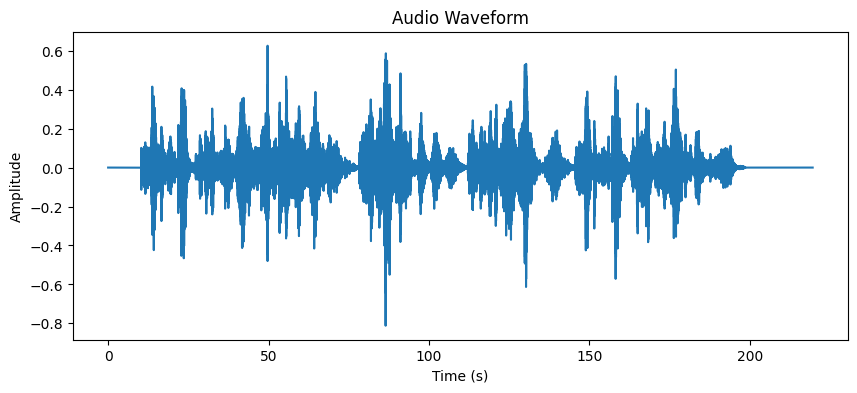

In [29]:
plt.figure(figsize=(10, 4))
time = np.arange(0, len(waveform)) / 44100
plt.plot(time, waveform)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Audio Waveform')
plt.show()

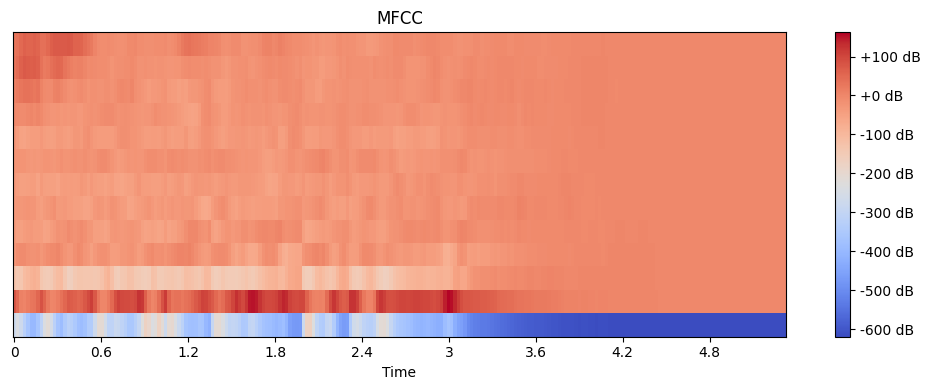

In [60]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def extract_mfcc(audio_data, sample_rate):
    # MFCC를 추출할 파라미터 설정
    n_mfcc = 13  # MFCC의 개수
    n_fft = 2048  # STFT(Fast Fourier Transform)에 사용되는 FFT 크기
    hop_length = 512  # STFT에서 프레임 간격

    # MFCC 추출
    mfcc = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=n_mfcc, n_fft=n_fft, hop_length=hop_length)

    return mfcc

# 오디오 파일 로드 (예시용으로 librosa의 sample 데이터를 사용)
audio_data, sample_rate = librosa.load(librosa.example('trumpet'), sr=None, mono=False)
# MFCC 추출
mfcc = extract_mfcc(audio_data, sample_rate)

# 결과 시각화
plt.figure(figsize=(10, 4))
librosa.display.specshow(mfcc, x_axis='time')
plt.colorbar(format='%+2.0f dB')
plt.title('MFCC')
plt.tight_layout()
plt.show()

In [63]:
audio_data.shape, sample_rate, mfcc.shape

((117601,), 22050, (13, 230))

In [74]:
mfcc = extract_mfcc(mono_audio, 44100)

In [75]:
mfcc.shape

(13, 21763)

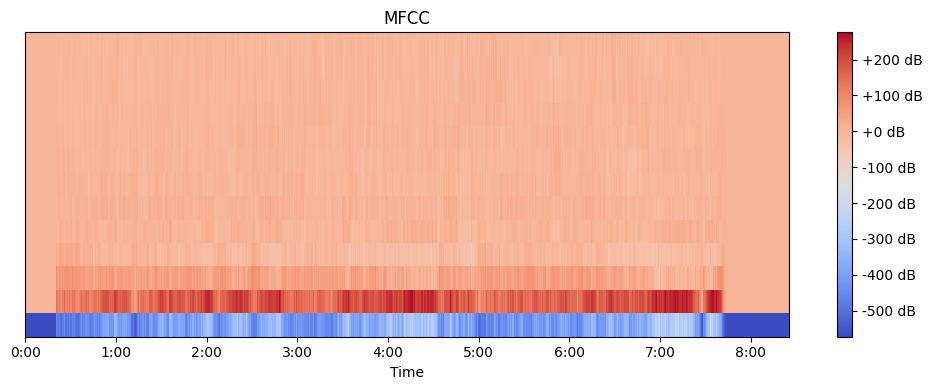

In [68]:
plt.figure(figsize=(10, 4))
librosa.display.specshow(mfcc, x_axis='time')
plt.colorbar(format='%+2.0f dB')
plt.title('MFCC')
plt.tight_layout()
plt.show()

In [56]:
video = mp.VideoFileClip("/opt/ml/ytdataset/audio_videos/train/103_Debussy “Valse romantique” Paul Barton FEURICH piano.mp4")

# 오디오 추출
audio_array = video.audio.to_soundarray()
mono_audio = np.mean(audio_array, axis=1)
# Mel spectrogram 추출
mel_spectrogram = torchaudio.transforms.MelSpectrogram(
    sample_rate=44100,
    n_fft=400,         # FFT 크기 (frame 크기)
    hop_length=160,    # frame 간격
    n_mels=128         # Mel band 개수
)(torch.tensor(mono_audio.T).float())
mel_spectrogram.shape

torch.Size([128, 69640])

In [59]:
# log-scale 변환
mel_spectrogram = torchaudio.transforms.AmplitudeToDB()(mel_spectrogram)

print(mel_spectrogram.shape)  # Mel spectrogram의 shape 출력

torch.Size([128, 69640])


In [54]:
len(glob.glob("/opt/ml/ytdataset/crop_images/train/103_Debussy “Valse romantique” Paul Barton FEURICH piano.mp4/*"))

6316

In [58]:
69640 // 6316

11

In [53]:
video.duration * video.fps

6316.5

In [33]:
waveform = audio_array.T

In [35]:
# 최대값과 최소값을 확인하여 스케일링
max_value = np.max(waveform)
min_value = np.min(waveform)
scaling_factor = max(abs(max_value), abs(min_value)) / 32767

# 스케일링 적용
scaled_waveform = (waveform / scaling_factor).astype(np.int16)

In [34]:
np.min(waveform), np.max(waveform)

(-0.96820068359375, 0.761138916015625)

In [37]:
waveform.shape

(2, 9683037)

In [38]:
from scipy.io import wavfile
wavfile.write("output.wav", 44100, audio_array)

In [39]:
waveform, sample_rate = torchaudio.load("output.wav")


In [44]:
waveform.shape, sample_rate, audio_array.shape

(torch.Size([2, 9683037]), 44100, (9683037, 2))

In [46]:
torch.tensor(audio_array.T).shape

torch.Size([2, 9683037])

In [47]:
# Mel spectrogram 추출
mel_spectrogram = torchaudio.transforms.MelSpectrogram(
    sample_rate=44100,
    n_fft=400,         # FFT 크기 (frame 크기)
    hop_length=160,    # frame 간격
    n_mels=128         # Mel band 개수
)(torch.tensor(audio_array.T).float())

In [48]:
mel_spectrogram.shape

torch.Size([2, 128, 60519])

In [ ]:
# Mel spectrogram 추출
mel_spectrogram = torchaudio.transforms.MelSpectrogram(
    sample_rate=sample_rate,
    n_fft=400,         # FFT 크기 (frame 크기)
    hop_length=160,    # frame 간격
    n_mels=128         # Mel band 개수
)(waveform)

In [ ]:
# Mel spectrogram 추출
mel_spectrogram = torchaudio.transforms.MelSpectrogram(
    sample_rate=sample_rate,
    n_fft=400,         # FFT 크기 (frame 크기)
    hop_length=160,    # frame 간격
    n_mels=128         # Mel band 개수
)(waveform)

# log-scale 변환
mel_spectrogram = torchaudio.transforms.AmplitudeToDB()(mel_spectrogram)

In [25]:
from IPython.display import Audio
Audio(waveform, rate=44100)

In [14]:
np.stack([audio_dict[1], audio_dict[1], audio_dict[1]], axis=0).shape

NameError: name 'audio_dict' is not defined

In [4]:
audio_array.shape[0] / 44100

219.57

Text(0.5, 1.0, 'Audio Waveform')

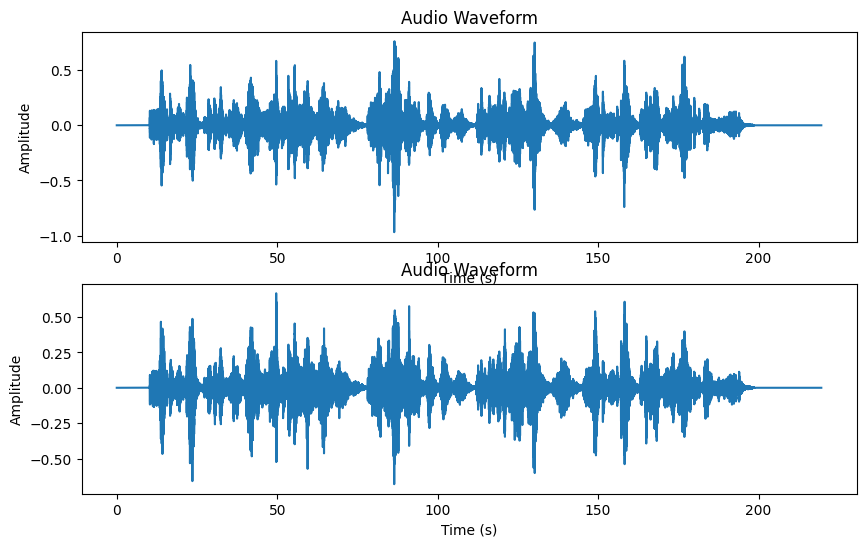

In [5]:
# audio_array 시각화
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 6))
time = np.arange(0, len(audio_array)) / 44100
axes[0].plot(time, audio_array[...,0])
axes[0].set_xlabel('Time (s)')
axes[0].set_ylabel('Amplitude')
axes[0].set_title('Audio Waveform')

axes[1].plot(time, audio_array[..., 1])
axes[1].set_xlabel('Time (s)')
axes[1].set_ylabel('Amplitude')
axes[1].set_title('Audio Waveform')

In [3]:
mono_audio = np.mean(audio_array, axis=1)

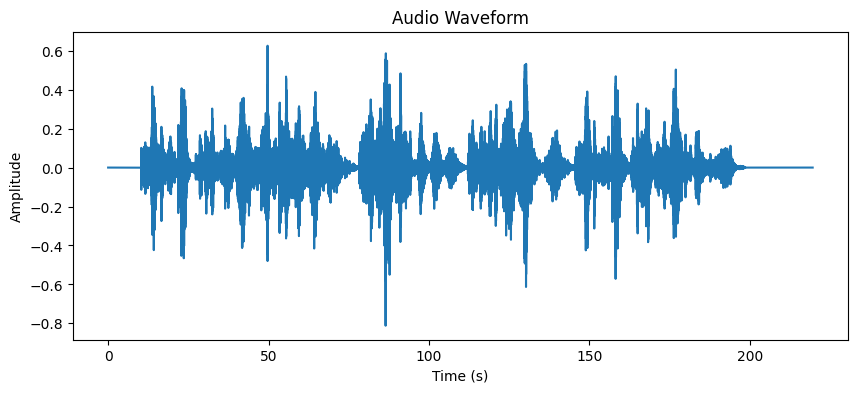

In [7]:
# audio_array 시각화
plt.figure(figsize=(10, 4))
time = np.arange(0, len(mono_audio)) / 44100
plt.plot(time, mono_audio)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Audio Waveform')
plt.show()

In [47]:
mono_audio.shape[0] / 44100

219.57

In [40]:
25 // 44100

0

In [51]:
audio_array.shape[0] // 44100 * 25

5475

In [41]:
video.duration

219.57

In [34]:
int(video.duration * video.fps)

5489

In [97]:
import sys
sys.path.append('/opt/ml/final_project/ultralytics')
from ultralytics import YOLO

Exception ignored in: <function Wave_write.__del__ at 0x7f5f09c70e50>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.8/wave.py", line 327, in __del__
    self.close()
  File "/opt/conda/lib/python3.8/wave.py", line 445, in close
    self._ensure_header_written(0)
  File "/opt/conda/lib/python3.8/wave.py", line 465, in _ensure_header_written
    raise Error('sample width not specified')
wave.Error: sample width not specified


In [107]:
model = YOLO("/opt/ml/level3_cv_finalproject-cv-08/detection_models/best.pt")

In [4]:
import glob
import pickle
frames = glob.glob("/opt/ml/ytdataset/images/train/100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano.mp4/*")
with open("/opt/ml/ytdataset/labels_audeo/training/100_Paul Rice “Waltz for Ella” FREE SHEET MUSIC P Barton FEURICH piano.mp4.pkl", "rb") as f:
    labels = pickle.load(f)


In [5]:
cnt = len(frames)
audio_frames = mono_audio.shape[0] // 44100 * 25
if audio_frames < cnt:
    mono_padded = np.pad(mono_audio, (0, int((cnt - audio_frames) / 25 * 44100)), mode='constant')

In [6]:
len(frames), list(labels.keys())[-1], mono_audio.shape[0] // 44100 * 25, mono_padded.shape[0] // 44100 * 25

(5489, 5489, 5475, 5500)

In [7]:
import math
samples_per_frame = math.ceil(mono_padded.shape[0] / len(frames))

In [8]:
frames_arr = []
for frame in frames:
    frames_arr.append(cv2.cvtColor(cv2.imread(frame), cv2.COLOR_BGR2GRAY))
frames_arr_all = np.stack(frames_arr, axis=0)

In [9]:
frames_arr_all.shape

(5489, 100, 900)

In [154]:
import torch
from Video2RollNet import resnet18
net = resnet18()
# print(net)
imgs = torch.rand((2, 5, 100,900))
logits = net(imgs)
print(logits.shape)

torch.Size([2, 76])


In [184]:
import torch.nn as nn

class LSTMModel(nn.Module):
    def __init__(self, input_size=5, hidden_size=256, num_layers=3, output_size=64):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # 초기 hidden state와 cell state 설정
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)

        # LSTM 모델 적용
        out, _ = self.lstm(x, (h0, c0))

        # 마지막 타임스텝의 hidden state를 추출하여 특징 벡터로 변환
        features = self.fc(out[:, -1, :])

        return features


In [185]:
x = torch.rand((5 ,256, 5))
lstm = LSTMModel()
lstm(x).shape

torch.Size([5, 64])

In [28]:
mono_samples = []
for i in range(5):
    mono_samples.append(mono_padded[i * samples_per_frame:(i + 1) * samples_per_frame])
x = torch.tensor(mono_samples).unsqueeze(0).permute(0, 2, 1)

In [186]:
lstm(x).shape

torch.Size([5, 64])

In [31]:
frame_chunk = []
audio_chunk = []
for i in range(len(frames_arr_all)):
    if len(frame_chunk) < 5:
        frame_chunk.append(frames_arr_all[i])
        audio_chunk.append(mono_padded[i * samples_per_frame:(i + 1) * samples_per_frame])
    else:
        break

In [32]:
x_frames = torch.tensor(frame_chunk).unsqueeze(0)
x_audio = torch.tensor(audio_chunk).unsqueeze(0).permute(0, 2, 1)
x_frames.shape, x_audio.shape

(torch.Size([1, 5, 100, 900]), torch.Size([1, 1769, 5]))

In [207]:
y_frames = net(x_frames.float())
y_audio = lstm(x_audio.float())
y = torch.concatenate([y_frames, y_audio], dim=1)

In [208]:
y.shape

torch.Size([1, 140])

In [33]:
from restm import RESTM
restm_net = RESTM()
restm_net(x_frames.float(), x_audio.float()).shape

torch.Size([1, 76])

In [10]:
min_key = 5
max_key = 80


In [36]:
labels[500]

array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0., 35.,  0.,  0.,  0.,  0., 39.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 50.,  0.,  0., 60.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.])

In [55]:
label = np.stack([labels[i] for i in range(1,6)], axis=0)
label = np.where(label > 0, 1, 0)
torch.tensor(label).unsqueeze(0).shape

torch.Size([1, 5, 88])

In [59]:
np.any(label)

False

In [39]:
samples_per_frame

1769

In [67]:
label.shape

(5, 88)

In [19]:
len(frames_arr_all)

5489

In [11]:
from restm import RESTM

restm_net = RESTM()

restm_net.cuda()
restm_net.train()

optimizer = torch.optim.Adam(restm_net.parameters(), lr=0.001, betas=(0.9, 0.999))
criterion = nn.BCEWithLogitsLoss()

losses = []
precisions = []
recalls = []

for i in range(10):
    for i in range(len(frames_arr_all)):
        if i >= 2 and i<len(frames)-2:
            label = np.stack([labels[i+1] for i in range(i-2, i+3)], axis=0)
            label = np.where(label > 0, 1, 0)
            new_label = label[..., min_key:max_key + 1]
            # count the number of frames that no key is activate
            if not np.any(new_label):
                # count_zero += 1
                continue

            frame_x = torch.tensor([frames_arr_all[j] for j in range(i-2, i+3)]).unsqueeze(0).float().cuda()
            audio_x = torch.tensor([mono_padded[j * samples_per_frame:(j + 1) * samples_per_frame] for j in range(i-2, i+3)]).unsqueeze(0).permute(0, 2, 1).float().cuda()
            label = torch.tensor(new_label).unsqueeze(0).float().cuda()

            logits = restm_net(frame_x, audio_x)

            loss = criterion(logits, label)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            pred_label = torch.sigmoid(logits) >= 0.4
            
            numpy_label = label.cpu().detach().numpy().astype(int)
            numpy_pre_label = pred_label.cpu().detach().numpy().astype(int)
                    
            precision = metrics.precision_score(numpy_label[:, j, :], numpy_pre_label[:, j, :], average='micro', zero_division=1) / 5
            recall = metrics.recall_score(numpy_label[:, j, :], numpy_pre_label[:, j, :], average='micro', zero_division=1) / 5

            losses.append(loss.cpu().detach().item())
            precisions.append(precision)
            recalls.append(recall)
            if i % 100 == 0:
                print(
                    "frame {0} loss:{1:.4f} | precision:{2:.3f} | recall:{3:.3f}".format(i+1, loss.item(), precision, recall))        

        else:
            continue    


frame 301 loss:0.1740 | precision:0.167 | recall:0.367
frame 401 loss:0.1360 | precision:0.717 | recall:0.480
frame 501 loss:0.1614 | precision:0.067 | recall:0.050
frame 601 loss:0.0944 | precision:0.827 | recall:0.800
frame 701 loss:0.1256 | precision:0.700 | recall:0.500
frame 801 loss:0.1069 | precision:0.400 | recall:0.400
frame 901 loss:0.0835 | precision:0.390 | recall:0.600
frame 1001 loss:0.2190 | precision:0.267 | recall:0.250
frame 1101 loss:0.1738 | precision:0.123 | recall:0.200
frame 1201 loss:0.2488 | precision:0.297 | recall:0.194
frame 1301 loss:0.1256 | precision:0.733 | recall:0.410
frame 1401 loss:0.0880 | precision:0.700 | recall:0.700
frame 1501 loss:0.1059 | precision:0.000 | recall:0.000
frame 1601 loss:0.1097 | precision:0.967 | recall:0.710
frame 1701 loss:0.0342 | precision:1.000 | recall:0.850
frame 1801 loss:0.1417 | precision:1.000 | recall:0.120
frame 1901 loss:0.0369 | precision:0.960 | recall:1.000
frame 2001 loss:0.1775 | precision:0.333 | recall:0.190

KeyboardInterrupt: 

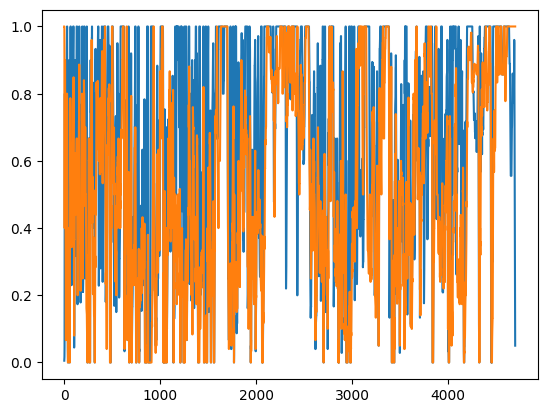

In [26]:
import matplotlib.pyplot as plt
plt.plot(losses)
plt.plot(precisions)
plt.plot(recalls)

In [48]:
loss.cpu().detach().item()

0.06075078621506691

In [150]:
sample_list = []
for i in range(len(frames)):
    sample_list.append(mono_padded[i * samples_per_frame:(i + 1) * samples_per_frame])
concatenated_samples = np.concatenate(sample_list)
concatenated_samples.shape,  mono_padded.shape[0]

((9709497,), 9709497)

In [50]:

frame.shape, cnt

((720, 1280, 3), 5490)

In [80]:
((cnt - audio_frames) / 25 * 44100)

26460.0

In [11]:
audio_frames

5475

In [91]:
mono_audio.shape[0] // 5490

1763

In [13]:
cnt = len(frames)

In [14]:
cnt = len(frames)
audio_frames = mono_audio.shape[0] // 44100 * 25
if audio_frames < cnt:
    mono_padded = np.pad(mono_audio, (0, int((cnt - audio_frames) / 25 * 44100)), mode='constant')

In [15]:
len(mono_padded) - len(mono_audio)

24696

In [17]:
mono_audio.shape[0] // 44100 * 25, mono_padded.shape[0] // 44100 * 25

(5475, 5500)

In [18]:
audio_array.shape

(9683037, 2)